# Conjugate Coastline Maps
This notebook uses the conjugate_map package to generate maps of the conjugate image of the Antarctic coastline over time. It is based on notebooks at https://github.com/KCollins/conjugate_map.

In [1]:
import conjugate_map.conj_calc as conj
import datetime as dt
import pandas as pd
import plotly.express as px
import geopandas
import gpxpy
import gpxpy.gpx
import json

import logging
logger = logging.getLogger(__name__)

Load IGRF coefficients ...


/home/pliny/.local/lib/python3.9/site-packages/pandas/core/computation/expressions.py:21: UserWarning: Pandas requires version '2.8.4' or newer of 'numexpr' (version '2.8.3' currently installed).
  from pandas.core.computation.check import NUMEXPR_INSTALLED
/home/pliny/.local/lib/python3.9/site-packages/numpy/core/getlimits.py:542: UserWarning: Signature b'\x00\xd0\xcc\xcc\xcc\xcc\xcc\xcc\xfb\xbf\x00\x00\x00\x00\x00\x00' for <class 'numpy.longdouble'> does not match any known type: falling back to type probe function.
This warnings indicates broken support for the dtype!
  machar = _get_machar(dtype)


Let's set a default date of 2007, the most recent International Polar Year:

In [2]:
year = 2007
ut = dt.datetime(year, 12, 1, 0, 0, 0)

### Antarctic Coastline

In [3]:
gdf = geopandas.read_file("stanford-yk702xd7587-geojson.json")
gdf.geometry

# df.geometry[0].exterior

points = []
for polygon in gdf.geometry[0]:
    for point in polygon.exterior.coords:
        points.append({"lat": point[1], "lon": point[0]})
Antarctic_coastline = pd.DataFrame(points)

with open('stanford-yk702xd7587-geojson.json') as f:
  Antarctic_coast = json.load(f)

/tmp/ipykernel_2057/3798994607.py:7: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  for polygon in gdf.geometry[0]:


We can visualize the geometry of the coastline directly in Jupyter notebook. Yep, looks like Antarctica:

In [4]:
gdf.geometry[0]

Let's compute the conjugate points for this outline, then export them as a .gpx file. That shape is *huge*, so let's  reduce the resolution so it's easier to run computations on.

In [5]:
foo = conj.conjcalc(Antarctic_coastline.sample(10000).sort_values('lon'), latname = 'lat', lonname='lon', dtime=ut)

df = foo[['PLAT', 'PLON']]

gpx = gpxpy.gpx.GPX()

# Create first track in our GPX:
gpx_track = gpxpy.gpx.GPXTrack()
gpx.tracks.append(gpx_track)

# Create first segment in our GPX track:
gpx_segment = gpxpy.gpx.GPXTrackSegment()
gpx_track.segments.append(gpx_segment)

# Create points:
for idx in df.index:
    gpx_segment.points.append(gpxpy.gpx.GPXTrackPoint(df.loc[idx, 'PLAT'], df.loc[idx, 'PLON']))

# print(gpx.to_xml())

with open('output/conj-Ant.gpx', 'w') as f:
    f.write(gpx.to_xml())


/home/pliny/.local/lib/python3.9/site-packages/conjugate_map/conj_calc.py:282: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'S' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.
  gdf.loc[index, 'Hemisphere'] = "S"


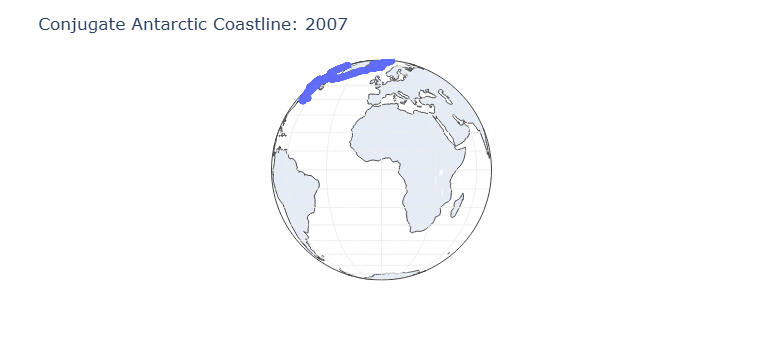

In [6]:
ant=foo.copy()
ant

fig = px.scatter_geo(ant,
                    lat=ant["PLAT"],
                    lon=ant["PLON"],
                    hover_data = ["PLAT", "PLON"]
                    )
fig.update_geos(projection_type="orthographic")
fig.update_geos(lataxis_showgrid=True, lonaxis_showgrid=True) # geographic graticules
fig.update_layout(title = "Conjugate Antarctic Coastline: " + str(year))
fig.show()
fig.write_html("output/AntarcticConjugate_" + str(year) + ".html")

## Static Version
This version of the map is used in the GEOSCOPR report.

In [7]:
# # CONJUGATE COASTLINE OVER TIME
gdf = geopandas.read_file("stanford-yk702xd7587-geojson.json")
gdf.geometry

# df.geometry[0].exterior

points = []
for polygon in gdf.geometry[0]:
    for point in polygon.exterior.coords:
        points.append({"lat": point[1], "lon": point[0]})
Antarctic_coastline = pd.DataFrame(points)
Antarctic_coastline = Antarctic_coastline.sample(10000)


stations_over_time = pd.DataFrame()
# for year in range(1900, 2020, 10): # continuous
for year in [1882, 1932, 1957, 2007, 2024]: # IPY only
    try:
        print("Computing for " + str(year) + "...................................................................")
        # run conjcalc for the year of interest
        data = conj.conjcalc(Antarctic_coastline, latname = 'lat', lonname = 'lon', dtime = dt.datetime(year, 1, 1), mode='S2N')
        # add year column to table
        data = pd.DataFrame(data)
        data['Year'] = year
        # append table to big table
        # stations_over_time.concat(data)
        stations_over_time = pd.concat([stations_over_time, data])
        print('Appending to main table.........................................')
        print(stations_over_time.shape)
        # stations_over_time = pd.concat(data)
        
    except Exception as e:
        print(e)
 

/tmp/ipykernel_2057/2723315971.py:8: ShapelyDeprecationWarning:

Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.



Computing for 1882...................................................................


/home/pliny/.local/lib/python3.9/site-packages/conjugate_map/conj_calc.py:282: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'S' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.



Appending to main table.........................................
(10000, 6)
Computing for 1932...................................................................


/home/pliny/.local/lib/python3.9/site-packages/conjugate_map/conj_calc.py:282: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'S' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.



Appending to main table.........................................
(20000, 6)
Computing for 1957...................................................................


/home/pliny/.local/lib/python3.9/site-packages/conjugate_map/conj_calc.py:282: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'S' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.



Appending to main table.........................................
(30000, 6)
Computing for 2007...................................................................


/home/pliny/.local/lib/python3.9/site-packages/conjugate_map/conj_calc.py:282: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'S' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.



Appending to main table.........................................
(40000, 6)
Computing for 2024...................................................................


/home/pliny/.local/lib/python3.9/site-packages/conjugate_map/conj_calc.py:282: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'S' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.



Appending to main table.........................................
(50000, 6)


/home/pliny/.local/lib/python3.9/site-packages/plotly/express/_core.py:1979: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



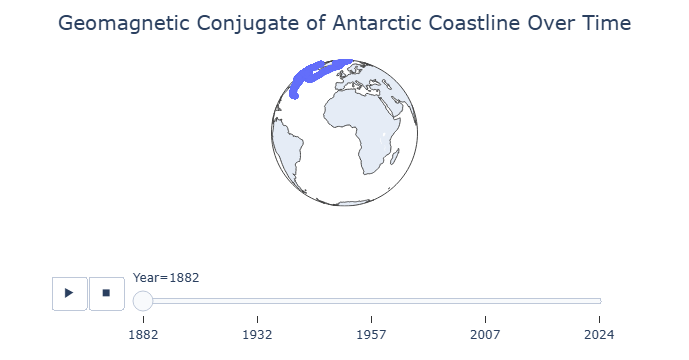

In [8]:
# Create the animation
world_map = px.scatter_geo(stations_over_time.reset_index(), lon='PLON', lat='PLAT', 
                           # color = 'Hemisphere',
                           # size = 'Year',  
                           animation_frame='Year', animation_group='Year', projection='orthographic', 
                           #hover_name='Name', hover_data = ['ID', 'Network']
                          )
# world_map = px.scatter_geo(world, lon='long', lat='lat', size='mass', color='orange', animation_frame='year', animation_group='group', projection='orthographic', hover_name='name')
world_map.update_layout(title='Geomagnetic Conjugate of Antarctic Coastline Over Time', title_x=0.5, title_font=dict(size=20))

# Display the animation
world_map.show()
world_map.write_html("output/animated-map-conjugate-coastline.html")

In [9]:
stations_over_time.head()

,lat,lon,Hemisphere,PLAT,PLON,Year
714846,-75.384895,-140.183853,S,58.165314,-89.672632,1882
558702,-79.636978,160.603653,S,71.129160,-87.537277,1882
564206,-80.388016,160.600525,S,70.716264,-85.258291,1882
986417,-79.289581,-69.427086,S,51.598621,-63.749004,1882
416140,-69.854683,75.694267,S,75.642056,-10.806320,1882


/home/pliny/.local/lib/python3.9/site-packages/plotly/express/_core.py:1979: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



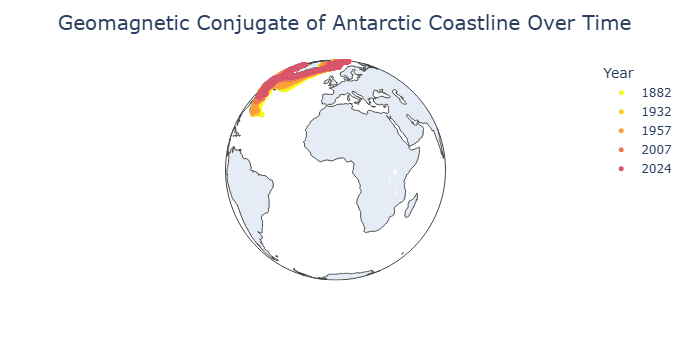

In [12]:
# Create a 2D representation
stations_over_time['Year '] = stations_over_time['Year'].astype(str)
world_map = px.scatter_geo(stations_over_time.reset_index(), lon='PLON', lat='PLAT', 
                           color = 'Year ', # for discrete colormap
                           color_discrete_sequence= px.colors.sequential.Plasma_r,
                           # size = 'Year',  # for continuous colormap
                           # animation_frame='Year', animation_group='Year', 
                           projection='orthographic'
                          )
# world_map = px.scatter_geo(world, lon='long', lat='lat', size='mass', color='orange', animation_frame='year', animation_group='group', projection='orthographic', hover_name='name')
world_map.update_layout(title='Geomagnetic Conjugate of Antarctic Coastline Over Time', title_x=0.5, title_font=dict(size=20))


world_map.update_traces(marker=dict(size=5))
# Display the map b
world_map.show()
world_map.write_html("output/overlaid-conjugate-coastline.html")